# Import des librairies

In [2]:
import math
import pandas as pd
from pandas_profiling import ProfileReport
import numpy as np
import time
%matplotlib inline
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier, plot_tree, export_graphviz
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, roc_curve, auc, precision_recall_curve
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

# Import du CSV

In [101]:
data = pd.read_csv("nba_logreg.csv")

# Analyse préalable des données

In [35]:
data

,Name,GP,MIN,PTS,FGM,FGA,FG%,3P Made,3PA,3P%,...,FTA,FT%,OREB,DREB,REB,AST,STL,BLK,TOV,TARGET_5Yrs
0,Brandon Ingram,36,27.4,7.4,2.6,7.6,34.7,0.5,2.1,25.0,...,2.3,69.9,0.7,3.4,4.1,1.9,0.4,0.4,1.3,0.0
1,Andrew Harrison,35,26.9,7.2,2.0,6.7,29.6,0.7,2.8,23.5,...,3.4,76.5,0.5,2.0,2.4,3.7,1.1,0.5,1.6,0.0
2,JaKarr Sampson,74,15.3,5.2,2.0,4.7,42.2,0.4,1.7,24.4,...,1.3,67.0,0.5,1.7,2.2,1.0,0.5,0.3,1.0,0.0
3,Malik Sealy,58,11.6,5.7,2.3,5.5,42.6,0.1,0.5,22.6,...,1.3,68.9,1.0,0.9,1.9,0.8,0.6,0.1,1.0,1.0
4,Matt Geiger,48,11.5,4.5,1.6,3.0,52.4,0.0,0.1,0.0,...,1.9,67.4,1.0,1.5,2.5,0.3,0.3,0.4,0.8,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1335,Chris Smith,80,15.8,4.3,1.6,3.6,43.3,0.0,0.2,14.3,...,1.5,79.2,0.4,0.8,1.2,2.5,0.6,0.2,0.8,0.0
1336,Brent Price,68,12.6,3.9,1.5,4.1,35.8,0.1,0.7,16.7,...,1.0,79.4,0.4,1.1,1.5,2.3,0.8,0.0,1.3,1.0
1337,Marlon Maxey,43,12.1,5.4,2.2,3.9,55.0,0.0,0.0,0.0,...,1.6,64.3,1.5,2.3,3.8,0.3,0.3,0.4,0.9,0.0
1338,Litterial Green,52,12.0,4.5,1.7,3.8,43.9,0.0,0.2,10.0,...,1.8,62.5,0.2,0.4,0.7,2.2,0.4,0.1,0.8,1.0


In [4]:
stat_analysis = ProfileReport(data)
stat_analysis

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Constats :
En regardant la corrélation entre la variable TARGET_5Yrs et les autres, nous n"observons qu"il n"y a pas de forte corrélation de manière particulière, nous ne supprimons donc aucune variable. En outre, nous n"observons pas de colonnes à mettre dans le bon format, ni de colonnes à classe unique. Cependant il existe 12 doublons que nous allons supprimer par la suite avec la colonne "Name" qui n"a pas d"intérêt non plus.

# Preprocessing

In [102]:
data.drop_duplicates(inplace = True)
data.drop(columns=["Name"], inplace=True)
data.dropna(inplace=True)

In [103]:
# Convesion des colonnes en float sauf GP
data = data.astype(float)
data["GP"] = data["GP"].astype(int)

In [61]:
print(len(data[data["TARGET_5Yrs"] == 1])/len(data))
print(len(data[data["TARGET_5Yrs"] == 0])/len(data))

0.6213960546282246
0.37860394537177544


il n'y a pas de déséquilibre important entre les 2 classes, il ne sera pas nécessaire de faire du resampling

# Arbre de Décision

## Choix des meilleurs paramètres

In [62]:
# Target and feaatures split
Y = data["TARGET_5Yrs"]
X =  data.drop(columns=["TARGET_5Yrs"])

# Hyperparameters space
param_space = {"criterion" : ["entropy", "gini"], 
               "max_depth" : list(range(2,10,1)),
               "min_samples_split" : [0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07],
               "random_state" : [42]}

# calling classifier
clf_grid = DecisionTreeClassifier()

start_time = time.time()
# running search
grid_search_tree = GridSearchCV(estimator = clf_grid,
                                param_grid = param_space,
                                scoring = "roc_auc",
                                cv = 10)
grid_search_tree.fit(X, Y.values)

delay = time.time() - start_time

# getting best model
best_parameters = grid_search_tree.best_params_
best_auc = grid_search_tree.best_score_
print("best parameters : " + str(best_parameters))
print("best auc : " + str(best_auc))
print("Time : " + str(delay))

best parameters : {'criterion': 'gini', 'max_depth': 4, 'min_samples_split': 0.06, 'random_state': 42}
best auc : 0.710030796600483
Time : 11.190284013748169


On essaye d"autres valeurs pour min_samples_split

In [64]:
# Hyperparameters space
param_space = {"criterion" : ["entropy", "gini"], 
               "max_depth" : list(range(2,10,1)),
               "min_samples_split":[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.],
               "random_state" : [42]}

# calling classifier
clf_grid = DecisionTreeClassifier()

start_time = time.time()
# running search
grid_search_tree = GridSearchCV(estimator=clf_grid,
                                param_grid=param_space,
                                scoring="roc_auc",
                                cv=10)
grid_search_tree.fit(X, Y.values)

delay = time.time() - start_time

# getting best model
best_parameters = grid_search_tree.best_params_
best_auc = grid_search_tree.best_score_
print("best parameters: " + str(best_parameters))
print("best auc: " + str(best_auc))
print("Time : " + str(delay))

best parameters: {'criterion': 'gini', 'max_depth': 8, 'min_samples_split': 0.2, 'random_state': 42}
best auc: 0.714464167419452
Time : 10.80792498588562


En effet, les AUC sont presque les mêmes, mais on partira sur les premiers paramètres qui nous donnent un arbre à 4 niveaux plutôt que 8 

## Entraînement et test

In [104]:
# calling classifier
clf_best = DecisionTreeClassifier(criterion = "gini", max_depth = 4, min_samples_split = 0.06, random_state = 42)

# splitting into train and test
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 42)

# running search
clf_best.fit(X_train, Y_train)

# prediction
estimate_best = clf_best.predict_proba(X_test)[:,1]
fpr, tpr, _ = roc_curve(Y_test,  estimate_best)
auc_dc = auc(fpr, tpr)

print("AUC : " + str(auc_dc)) 

AUC : 0.7282702237521514


## Interprétation et analyse

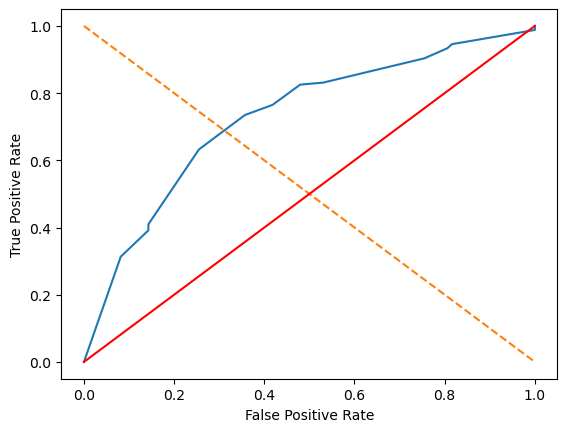

In [68]:
# getting roc curve
plt.plot(fpr,tpr)

plt.ylabel("True Positive Rate")
plt.xlabel("False Positive Rate")
plt.plot(np.arange(0, 1.2, 0.2), np.arange(1,-0.2,-0.2), "--")
plt.plot(np.arange(0, 1.2, 0.2), np.arange(0, 1.2, 0.2), "r-")
plt.show()

Ci-dessus nous pouvons voir la courbe ROC ayant la meilleur AUC

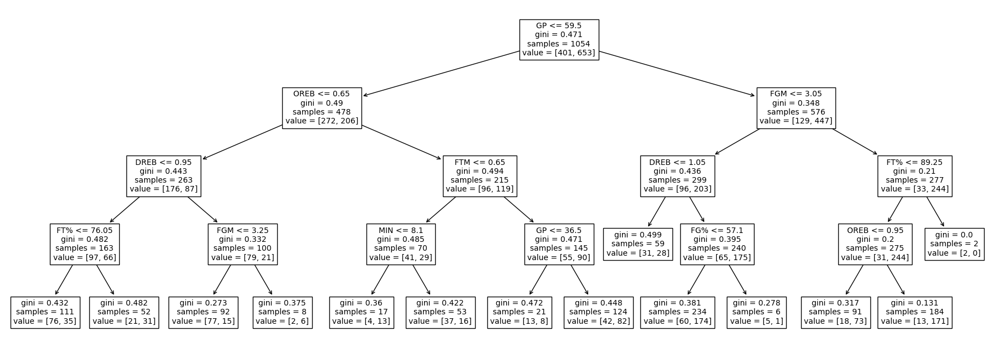

In [67]:
# plotting tree
plt.figure(figsize = (23,8))
plot_tree(clf_best, feature_names = list(X_train.columns), fontsize = 10)
plt.show()

Ci-dessus nous pouvons voir le meilleur arbre de décision avec les meilleurs attribut et valeur de split sur chaque noeud 

# Random Forest

## Choix des meilleurs paramètres

### Random Search

In [69]:
# Hyperparameters space
param_space = {"n_estimators" : [10,15,20,30, 40],
               "criterion" : ["log_loss", "entropy", "gini"], 
               "max_depth" : list(range(2,8,1)),
               "min_samples_split" : [0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.1],
               "random_state" : [42]}

# calling classifier
rf_search = RandomForestClassifier()

start_time = time.time()
# running search
random_search_rf = RandomizedSearchCV(estimator = rf_search,
                                      param_distributions = param_space,
                                      n_iter = 70,
                                      scoring = "roc_auc",
                                      cv = 8)
# running search
random_search_rf.fit(X, Y.values)

delay = time.time() - start_time

# getting best model
best_parameters_rf = random_search_rf.best_params_
best_auc_rf = random_search_rf.best_score_
print("best parameters: " + str(best_parameters_rf))
print("best auc: " + str(best_auc_rf))
print("Time : " + str(delay))

best parameters: {'random_state': 42, 'n_estimators': 15, 'min_samples_split': 0.03, 'max_depth': 5, 'criterion': 'entropy'}
best auc: 0.7469954109806222
Time : 18.585778951644897


/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
200 fits failed out of a total of 560.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
200 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py", line 450, in fit
    trees = Parallel(
  File "/Users/adham/opt/anaconda3/lib/python3.9/site-packages/joblib/parallel.py", line 1043, in __call__
    if self.dispatch_one_batch(iterator):
  

In [70]:
param_space = {"n_estimators" : [10,15,20,30, 40],
               "criterion" : ["log_loss", "entropy", "gini"], 
               "max_depth" : list(range(2,8,1)),
               "min_samples_split" : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.],
               "random_state" : [42]}

# calling classifier
rf_search = RandomForestClassifier()

start_time = time.time()
# running search
random_search_rf = RandomizedSearchCV(estimator = rf_search,
                                      param_distributions = param_space,
                                      n_iter = 70,
                                      scoring = "roc_auc",
                                      cv = 8)
# running search
random_search_rf.fit(X, Y.values)

delay = time.time() - start_time

# getting best model
best_parameters_rf = random_search_rf.best_params_
best_auc_rf = random_search_rf.best_score_
print("best parameters: " + str(best_parameters_rf))
print("best auc: " + str(best_auc_rf))
print("Time : " + str(delay))

best parameters: {'random_state': 42, 'n_estimators': 20, 'min_samples_split': 0.1, 'max_depth': 6, 'criterion': 'entropy'}
best auc: 0.7437484306629357
Time : 14.59865403175354


/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
240 fits failed out of a total of 560.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
240 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py", line 450, in fit
    trees = Parallel(
  File "/Users/adham/opt/anaconda3/lib/python3.9/site-packages/joblib/parallel.py", line 1043, in __call__
    if self.dispatch_one_batch(iterator):
  

Nous opterions plutôt pour la première solution avec une 15 estimateurs ayant une profondeur maximum de 5 (conte 20 et 6 respectvement pour la deuxième) vue que nous avons des AUC très simillaires. Regargdons maintenant si nous pouvons obtenir un meilleur résultat avec la cross-validation gridseaarch

### Grid search

In [71]:
# Hyperparameters space
param_space = {"n_estimators":[10,15,20,30, 40],
               "criterion":["log_loss", "entropy", "gini"], 
               "max_depth": list(range(2,8,1)),
               "min_samples_split":[0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.1],
               "random_state": [42]}

# calling classifier
rf_grid = RandomForestClassifier()

start_time = time.time()
# running search
grid_search_rf = GridSearchCV(estimator=rf_grid,
                                param_grid=param_space,
                                scoring="roc_auc",
                                cv=8)
grid_search_rf.fit(X, Y.values)

delay = time.time() - start_time

# getting best model
best_parameters_rf = grid_search_rf.best_params_
best_auc_rf = grid_search_rf.best_score_
print("best parameters: " + str(best_parameters_rf))
print("best auc: " + str(best_auc_rf))
print("Time : " + str(delay))

best parameters: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 0.03, 'n_estimators': 20, 'random_state': 42}
best auc: 0.748949241717775
Time : 167.61988711357117


/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
1680 fits failed out of a total of 5040.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1680 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py", line 450, in fit
    trees = Parallel(
  File "/Users/adham/opt/anaconda3/lib/python3.9/site-packages/joblib/parallel.py", line 1043, in __call__
    if self.dispatch_one_batch(iterator):

In [72]:
# Hyperparameters space
param_space = {"n_estimators":[10,15,20,30, 40],
               "criterion":["log_loss", "entropy", "gini"], 
               "max_depth": list(range(2,8,1)),
               "min_samples_split":[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.],
               "random_state": [42]}

# calling classifier
rf_grid = RandomForestClassifier()

start_time = time.time()
# running search
grid_search_rf = GridSearchCV(estimator=rf_grid,
                                param_grid=param_space,
                                scoring="roc_auc",
                                cv=8)
grid_search_rf.fit(X, Y.values)

delta_time_gridS = time.time() - start_time

# getting best model
best_parameters_rf = grid_search_rf.best_params_
best_auc_rf = grid_search_rf.best_score_
print("best parameters: " + str(best_parameters_rf))
print("best auc: " + str(best_auc_rf))
print("Time : " + str(delay))

best parameters: {'criterion': 'entropy', 'max_depth': 6, 'min_samples_split': 0.1, 'n_estimators': 30, 'random_state': 42}
best auc: 0.744467157796062
Time : 167.61988711357117


/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
2400 fits failed out of a total of 7200.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2400 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py", line 450, in fit
    trees = Parallel(
  File "/Users/adham/opt/anaconda3/lib/python3.9/site-packages/joblib/parallel.py", line 1043, in __call__
    if self.dispatch_one_batch(iterator):

Nous remarquons des AUC simillaires; les paramètres générées par la cross-validaion randomsearch sont donc adéquats.

## Entraînement et test

In [105]:
# calling classifier
clf_best = RandomForestClassifier(criterion = "entropy", max_depth = 5, min_samples_split = 0.03, n_estimators = 15, random_state = 42)

# splitting into train test
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state=42)

# fitting model
clf_best.fit(X_train, Y_train)

# prediction
estimate_best = clf_best.predict_proba(X_test)[:,1]
fpr, tpr, _ = roc_curve(Y_test,  estimate_best)
auc_rf = auc(fpr, tpr)

print("AUC : " + str(auc_rf))

AUC : 0.7566080649127123


## Interprétation et analyse

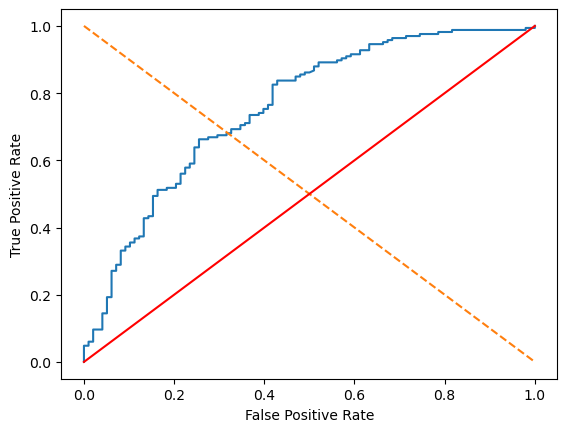

In [74]:
# getting roc curve
plt.plot(fpr,tpr)

plt.ylabel("True Positive Rate")
plt.xlabel("False Positive Rate")
plt.plot(np.arange(0, 1.2, 0.2), np.arange(1,-0.2,-0.2), "--")
plt.plot(np.arange(0, 1.2, 0.2), np.arange(0, 1.2, 0.2), "r-")
plt.show()

Ci-dessus nous pouvons voir la courbe ROC ayant la meilleur AUC

# Régression logistique

## Choix des meilleurs paramètres

### RandomSearch

In [94]:
# Hyperparameters space
param_space = {
    "penalty": ["l1", "l2", "elasticnet"],
    "max_iter" : range(300,500),
    "warm_start" : [True, False],
    "solver" : ["newton-cg", "lbfgs", "liblinear", "sag", "saga"], 
    "C" : [0.01, 0.05, 0.1, 5, 10, 15],
}

# calling classifier
lr_grid = LogisticRegression()

start_time = time.time()
# running search
random_search_lr = RandomizedSearchCV(estimator = lr_grid,
                              param_distributions = param_space,
                              scoring = "roc_auc",
                              cv = 8)
# running search
random_search_lr.fit(X, Y.values)

delay = time.time() - start_time

# getting best model
best_parameters_lr = random_search_lr.best_params_
best_auc_lr = random_search_lr.best_score_
print("best parameters: " + str(best_parameters_lr))
print("best auc: " + str(best_auc_lr))
print("Time : " + str(delay))

/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/adham/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/adham/opt/anaconda3/lib/python3.9/site-pack

best parameters: {'warm_start': True, 'solver': 'newton-cg', 'penalty': 'l2', 'max_iter': 444, 'C': 15}
best auc: 0.7570880881322151
Time : 2.7362308502197266


### Grid Search

In [ ]:
# Hyperparameters space
param_space = {
    "penalty": ["l1", "l2", "elasticnet"],
    "max_iter" : range(200,500),
    "warm_start" : [True, False],
    "solver" : ["newton-cg", "lbfgs", "liblinear", "sag", "saga"],
    "C" : [0.01, 0.05, 0.1, 5, 10, 15],
}

# calling classifier
lr_grid = LogisticRegression()

start_time = time.time()
# running search
grid_search_lr = GridSearchCV(estimator = lr_grid,
                              param_grid = param_space,
                              scoring = "roc_auc",
                              cv = 8)
grid_search_lr.fit(X, Y.values)

delay = time.time() - start_time

# getting best model
best_parameters_lr = grid_search_lr.best_params_
best_auc_lr = grid_search_lr.best_score_
print("best parameters: " + str(best_parameters_lr))
print("best auc: " + str(best_auc_lr))
print("Time : " + str(delay))

Vue que le temps d'exécution dépassait les 12 minutes et que nous avions eu une bonne AUC en utilisant la cross-=vaalidation random search, nous nous contenterons des paramètres obtenues grâce à celle-ci.

## Entraînement et test

In [106]:
# calling classifier
clf_lr = LogisticRegression(warm_start = True, solver = "newton-cg", penalty= "l2", max_iter= 444, C= 15)

# fitting on data
clf_lr = clf_lr.fit(X_train, Y_train)

# estimating on test
estimate_lr = clf_lr.predict_proba(X_test)[:,1]
true = Y_test

# prediction
fpr, tpr, _ = roc_curve(Y_test,  estimate_lr)
auc_lr = auc(fpr, tpr)

print("AUC : " + str(auc_lr))

AUC : 0.7754794688959921


## Interprétation et analyse

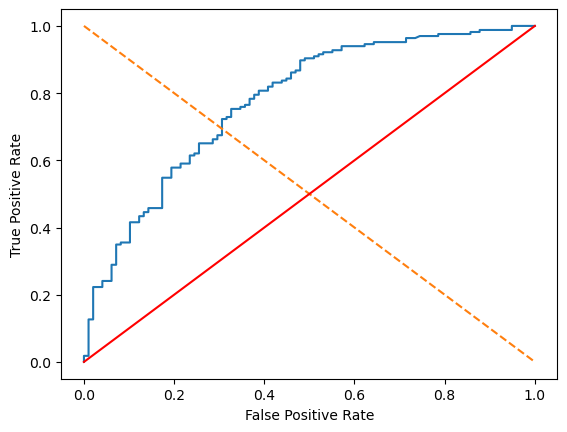

In [100]:
# getting roc curve
plt.plot(fpr,tpr)

plt.ylabel("True Positive Rate")
plt.xlabel("False Positive Rate")
plt.plot(np.arange(0, 1.2, 0.2), np.arange(1,-0.2,-0.2), "--")
plt.plot(np.arange(0, 1.2, 0.2), np.arange(0, 1.2, 0.2), "r-")
plt.show()

# Conclusion

Entraînés sur les mêmes données d'entraînement et testés sur les mêmes données de test, on obtient les différentes AUC suivantes :<br/><br/>
Arbre de décision : 0.7282702237521514<br/>
Random forest : 0.7566080649127123<br/>
Régression logistique : 0.7754794688959921<br/><br/>

Après avoir fait cette comparaison, nous allons donc choisir la régression logistique